<a href="https://colab.research.google.com/github/DanialBahrami/power_demand_prediction/blob/main/power_demand_draft.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Electricity Demand Prediction for the next day (next 24 hours).**

*Objective:*

>  We need to predict the demand for the next 24 hours by utilizing past electricity demand data points, humidity, temperature, dew point, and other drivers like weekdays, holidays, and etc. The accuracy of this model is so critical (Accuracy > 0.95 for a sample day is acceptable, or AE < 700 in july or august months)

Inputs: 

- Excel file containing all drivers


Data Considerations: 

- The data set may contain outliers and abnormal values.

Output: 

- A 24-hour demand forecast for a sample day

Success Criteria: 

- The acceptable error rate must be less than 5% (MAE < 500 MW, or accuracy more than 95%)

Deliverables: 

- A clean and understandable Jupyter file with well-documented code
- An explanation of the work process in a meeting (no file submission required)

Deadline: 

- five days after the task description has been sent

Evaluation:

- The work will be evaluated based on the accuracy of the electricity demand forecast, the clarity of the code and documentation, and the overall effectiveness of the solution.




In [ ]:
import os
import datetime

import IPython
import IPython.display
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf

mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

In [ ]:
# google drive conncection
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# read data 
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/CamrosTech/Dataset.csv',
					index_col ='Date',
					parse_dates = True)

# Print the first five rows of the dataset
df.head()
df_orginal = df.copy()
df_orginal

,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
Date,,,,,,,,,,,
2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67
2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63
2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59
2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39
2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35
...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,Thursday,19,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66
2020-12-31,Thursday,20,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76
2020-12-31,Thursday,21,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81


**EDA and Data Profiling**

In [ ]:
df.reset_index(inplace=True)
df

,Date,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
0,2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67
1,2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63
2,2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59
3,2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39
4,2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35
...,...,...,...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,Thursday,19,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66
39404,2020-12-31,Thursday,20,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76
39405,2020-12-31,Thursday,21,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81
39406,2020-12-31,Thursday,22,27.85,15744,-0.8,-6.76,17,-4.11,70,-5.6,100.90


I've used ydata (pandas profiling) for feature analysis. link to the library: https://github.com/ydataai/ydata-profiling

In [ ]:
# using ydata (panda profiling) for feature analysis
!pip install ydata-profiling
IPython.display.clear_output()

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, tsmode=True, sortby="Date", title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Remove Multicollinearity**

When two or more variables are highly correlated, they carry almost the same information, making it redundant to include all of them in a model. This can lead to a problem known as multicollinearity 

In [ ]:
corr = df.corr()

<ipython-input-7-45893e33df67>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df.corr()


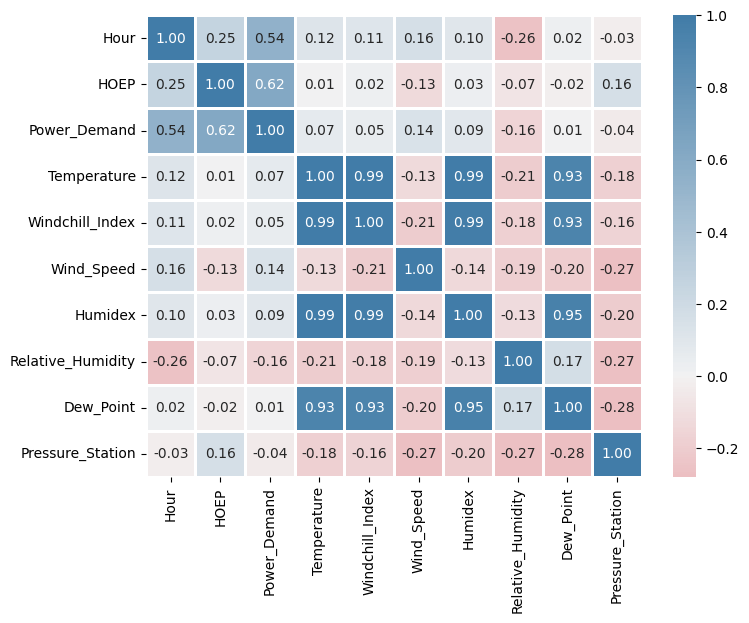

In [ ]:
cmap = sns.diverging_palette(h_neg=10, h_pos=240, as_cmap=True)
sns.heatmap(corr, cmap=cmap, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

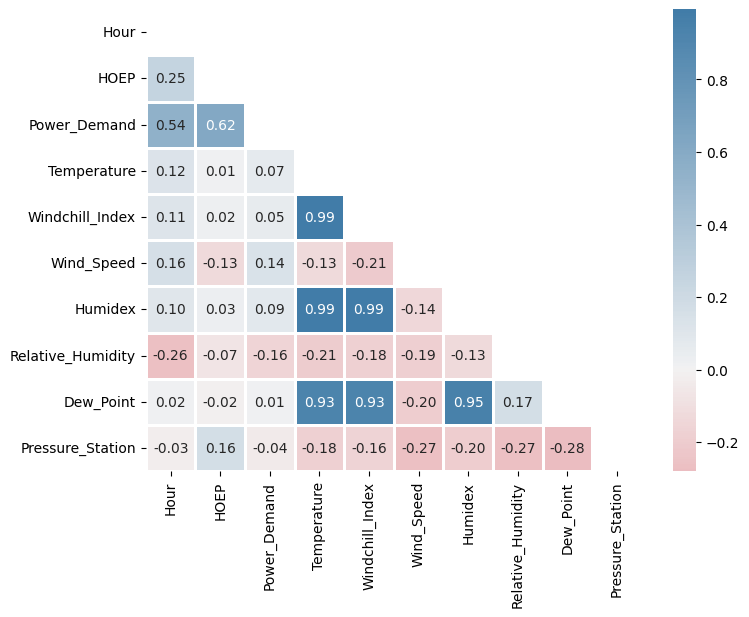

In [ ]:
mask = np.triu(np.ones_like(corr, dtype=bool))
sns.heatmap(corr, cmap=cmap, mask=mask, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

In [ ]:
#create positive correlation matrix
corr_pos = corr.abs()
corr_pos_tri= corr_pos.mask(mask)
corr_pos_tri

,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
Hour,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HOEP,0.251456,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Power_Demand,0.543581,0.615273,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Temperature,0.119294,0.009442,0.066501,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Windchill_Index,0.109306,0.020256,0.053868,0.993878,NaN,NaN,NaN,NaN,NaN,NaN
Wind_Speed,0.160503,0.128610,0.138297,0.127319,0.207184,NaN,NaN,NaN,NaN,NaN
Humidex,0.101408,0.030895,0.087921,0.991548,0.987675,0.137766,NaN,NaN,NaN,NaN
Relative_Humidity,0.263691,0.070164,0.159712,0.205372,0.179861,0.189601,0.125058,NaN,NaN,NaN
Dew_Point,0.018391,0.015680,0.008641,0.926284,0.929150,0.198264,0.950906,0.171680,NaN,NaN
Pressure_Station,0.026880,0.164161,0.038740,0.184491,0.163875,0.265545,0.200440,0.269235,0.280142,NaN


In [ ]:
drop_cand = [c for c in corr_pos_tri.columns if any(corr_pos_tri[c] >= 0.95) or any(corr_pos_tri.loc[c] >= 0.95)]
drop_cand

['Temperature', 'Windchill_Index', 'Humidex', 'Dew_Point']

In [ ]:
corr_pos_tri.loc[drop_cand, 'Power_Demand'].sort_values(ascending=False)

Humidex            0.087921
Temperature        0.066501
Windchill_Index    0.053868
Dew_Point          0.008641
Name: Power_Demand, dtype: float64

In [ ]:
to_drop = ['Temperature', 'Windchill_Index', 'Dew_Point']
df_reduced = df.drop(to_drop, axis=1)
df_reduced

,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,Friday,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,Friday,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,Friday,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,Friday,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,Friday,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,Thursday,19,36.85,17384,13,-2.69,74,100.66
39404,2020-12-31,Thursday,20,19.69,16783,16,-3.58,65,100.76
39405,2020-12-31,Thursday,21,20.78,16154,12,-3.67,80,100.81
39406,2020-12-31,Thursday,22,27.85,15744,17,-4.11,70,100.90


<ipython-input-14-44ee6ed46b1a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_r = df_reduced.corr()


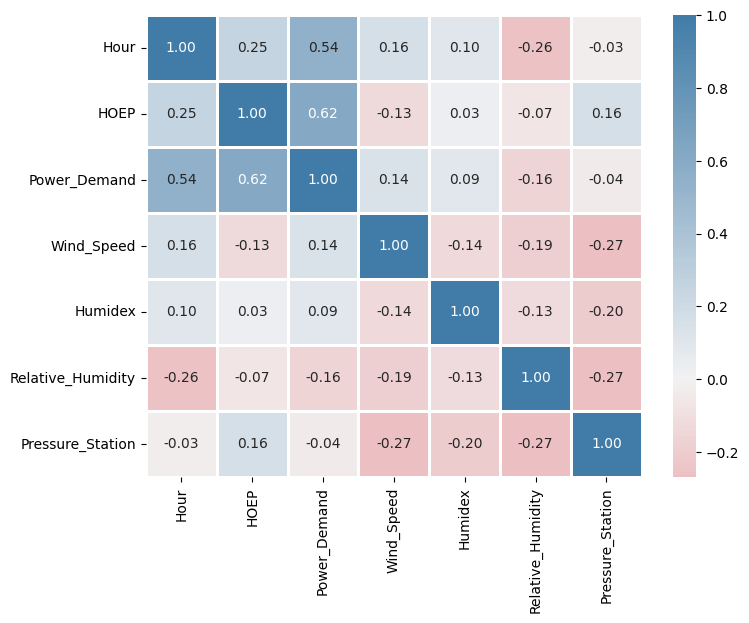

In [ ]:
corr_r = df_reduced.corr()
cmap = sns.diverging_palette(h_neg=10, h_pos=240, as_cmap=True)
sns.heatmap(corr_r, cmap=cmap, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

**Removing Outliers**

In [ ]:
print(df_reduced.shape)
print(df_reduced.columns)
df_reduced.head()

(39408, 9)
Index(['Date', 'Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed',
       'Humidex', 'Relative_Humidity', 'Pressure_Station'],
      dtype='object')


,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,4,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,4,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,4,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,4,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,4,13,0.00,14443,19,-5.09,84,99.35


Handling Categorical Variable, Weekday

In [ ]:
days = {'Monday':0, 'Tuesday':1, 'Wednesday':2, 'Thursday':3, 'Friday':4, 'Saturday':5, 'Sunday':6}
df_reduced['Weekday'] = df_reduced['Weekday'].map(days)
df_reduced

,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,4,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,4,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,4,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,4,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,4,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,3,19,36.85,17384,13,-2.69,74,100.66
39404,2020-12-31,3,20,19.69,16783,16,-3.58,65,100.76
39405,2020-12-31,3,21,20.78,16154,12,-3.67,80,100.81
39406,2020-12-31,3,22,27.85,15744,17,-4.11,70,100.90


In [ ]:
df_nd = df_reduced.drop(columns=['Date'])

In [ ]:
def check_outliers_boxplot(df):
  mean = df.mean()
  std = df.std()
  df_scaled = (df - mean) / std
  df_melt = df_scaled.melt(var_name='Column', value_name='Value')
  plt.figure(figsize=(df.shape[1], 6))
  ax = sns.boxplot(x='Column', y='Value', data=df_melt)
  _ = ax.set_xticklabels(df.keys(), rotation=90)

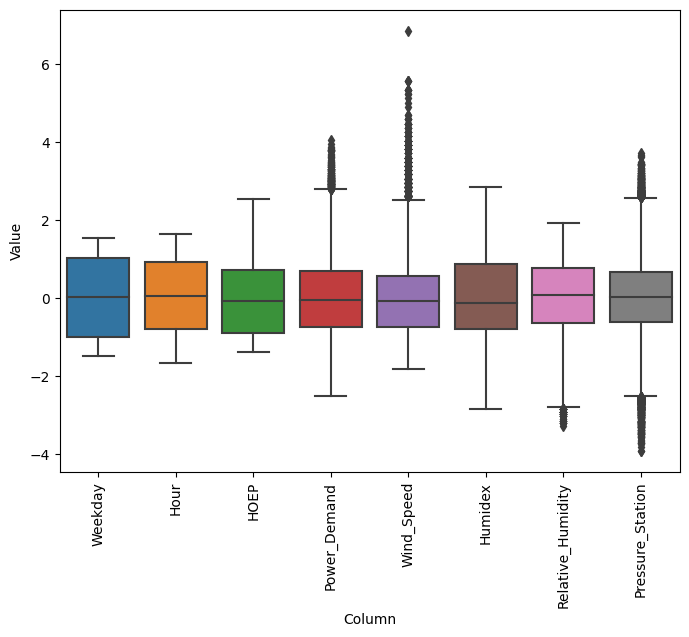

In [ ]:
check_outliers_boxplot(df_nd)

**Inter Quantile Range (IQR)**

In [ ]:
def IQR(df, column):
  # IQR
  # Calculate the upper and lower limits
  Q1 = df[column].quantile(0.25)
  Q3 = df[column].quantile(0.75)
  IQR = Q3 - Q1
  lower = Q1 - 1.5*IQR
  upper = Q3 + 1.5*IQR

  indexes = df.loc[(df[column]<=lower) | (df[column]>= upper)].index

  return lower, upper, indexes

In [ ]:
df_clean = df_reduced.copy()

In [ ]:
for c in df_clean.columns:
  if c != 'Date':
    lower_bond, upper_bond, outliers_index = IQR(df_clean, c)
    print("# outliers in column " + str(c) + " -> " + str(len(outliers_index)) + 
          " Lower Limit is " + str(lower_bond) + " Upper Limit is " + str(upper_bond))
    df_clean.drop(outliers_index, inplace=True)

# outliers in column Weekday -> 0 Lower Limit is -5.0 Upper Limit is 11.0
# outliers in column Hour -> 0 Lower Limit is -12.0 Upper Limit is 36.0
# outliers in column HOEP -> 0 Lower Limit is -25.515 Upper Limit is 51.325
# outliers in column Power_Demand -> 154 Lower Limit is 9116.0 Upper Limit is 21540.0
# outliers in column Wind_Speed -> 863 Lower Limit is -8.0 Upper Limit is 40.0
# outliers in column Humidex -> 0 Lower Limit is -37.525000000000006 Upper Limit is 58.275000000000006
# outliers in column Relative_Humidity -> 76 Lower Limit is 21.0 Upper Limit is 117.0
# outliers in column Pressure_Station -> 622 Lower Limit is 97.6 Upper Limit is 101.52000000000001


In [ ]:
print("Number of Removed Outliers: " + str(df_reduced.shape[0] - df_clean.shape[0]))

Number of Removed Outliers: 1715


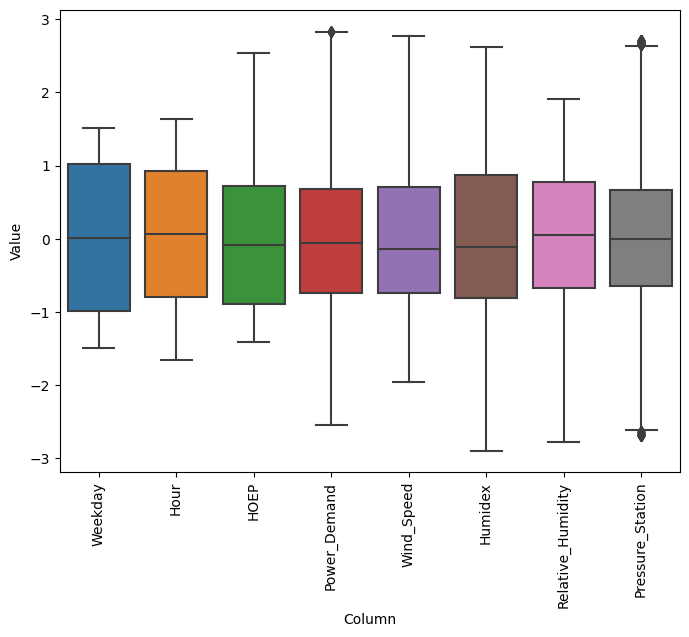

In [ ]:
check_outliers_boxplot(df_clean.drop(columns=['Date']))

t-SNE Visualization to check outliers in 2-dim space

In [ ]:
#t-SNE visualization 
from sklearn.manifold import TSNE
m = TSNE()

In [ ]:
tsne_features = m.fit_transform(df_nd)

In [ ]:
tsne_features.shape

(39408, 2)

In [ ]:
df_tsne = df_nd.copy()

In [ ]:
df_tsne['X'] = tsne_features[:, 0]
df_tsne['Y'] = tsne_features[:, 1]

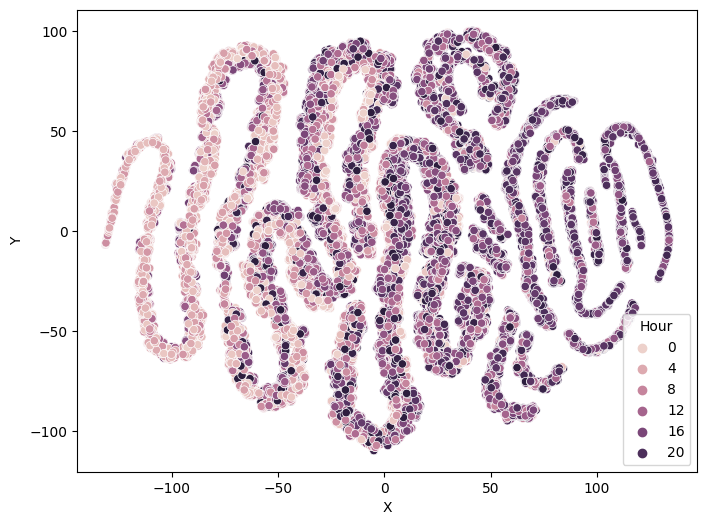

In [ ]:
sns.scatterplot(data=df_tsne, x="X", y="Y", hue="Hour")
plt.show()

**Isolated Forest for Anomaly Detection**

To simplify the process, I utilized Pycaret, a framework known for its user-friendly interface and ease of use. https://github.com/pycaret/pycaret

In [ ]:
!pip install --upgrade pycaret
IPython.display.clear_output()

In [ ]:
from pycaret.anomaly import *
s = setup(df_nd, session_id = 123)

,Description,Value
0,Session id,123
1,Original data shape,"(39408, 8)"
2,Transformed data shape,"(39408, 8)"
3,Numeric features,8
4,Preprocess,True
5,Imputation type,simple
6,Numeric imputation,mean
7,Categorical imputation,mode
8,CPU Jobs,-1
9,Use GPU,False


In [ ]:
iforest = create_model('iforest')

Processing:   0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
iforest_results = assign_model(iforest)
iforest_results.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Anomaly,Anomaly_Score
0,4,0,0.49,14023,20,-3.18,70,99.669998,0,-0.083681
1,4,1,-1.09,13417,25,-3.48,68,99.629997,0,-0.085557
2,4,2,-2.41,12968,26,-3.43,73,99.589996,0,-0.085546
3,4,12,0.00,14215,23,-4.86,76,99.389999,0,-0.108381
4,4,13,0.00,14443,19,-5.09,84,99.349998,0,-0.105044


In [ ]:
iforest_results['Anomaly'].sum()

1971

In [ ]:
df_tsne['Anomaly'] = iforest_results['Anomaly']

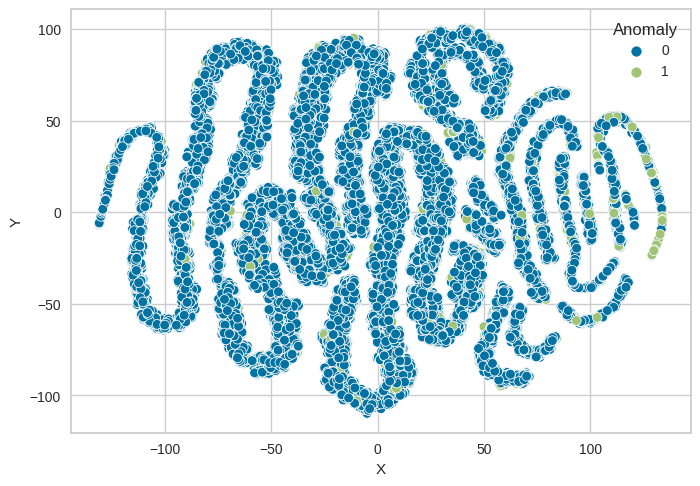

In [ ]:
sns.scatterplot(data=df_tsne, x="X", y="Y", hue="Anomaly")
plt.show()

In [ ]:
df_tsne.columns

Index(['Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed', 'Humidex',
       'Relative_Humidity', 'Pressure_Station', 'X', 'Y', 'Anomaly'],
      dtype='object')

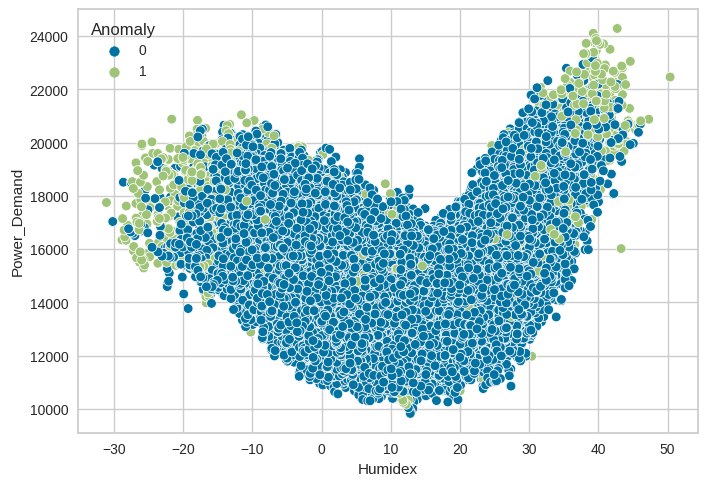

In [ ]:
sns.scatterplot(data=df_tsne, x="Humidex", y="Power_Demand", hue="Anomaly")
plt.show()

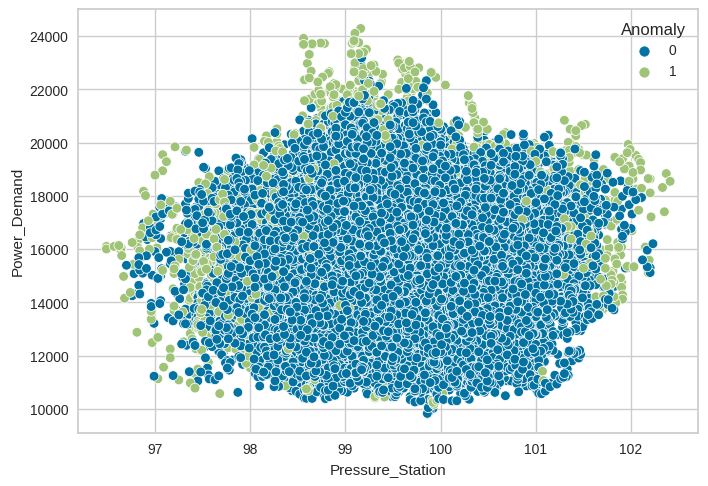

In [ ]:
sns.scatterplot(data=df_tsne, x="Pressure_Station", y="Power_Demand", hue="Anomaly")
plt.show()

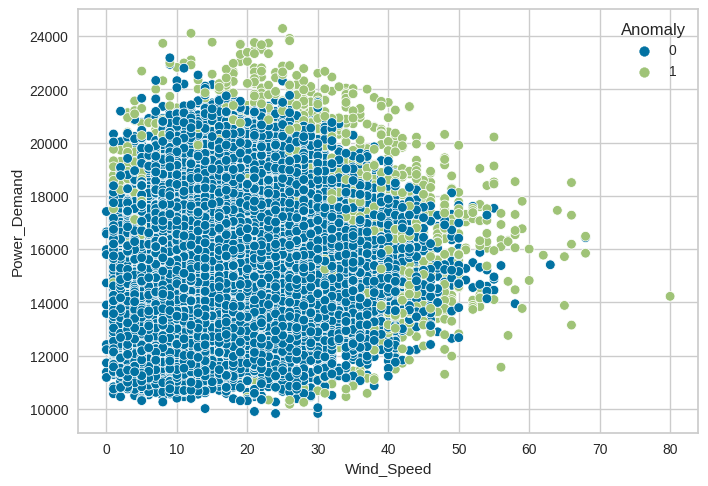

In [ ]:
sns.scatterplot(data=df_tsne, x="Wind_Speed", y="Power_Demand", hue="Anomaly")
plt.show()

In [ ]:
df_ifo = iforest_results.drop(iforest_results.loc[iforest_results['Anomaly']==True].index)

In [ ]:
df_ifo.drop(columns=['Anomaly', 'Anomaly_Score'], inplace=True)

In [ ]:
df_ifo.shape

(37437, 8)

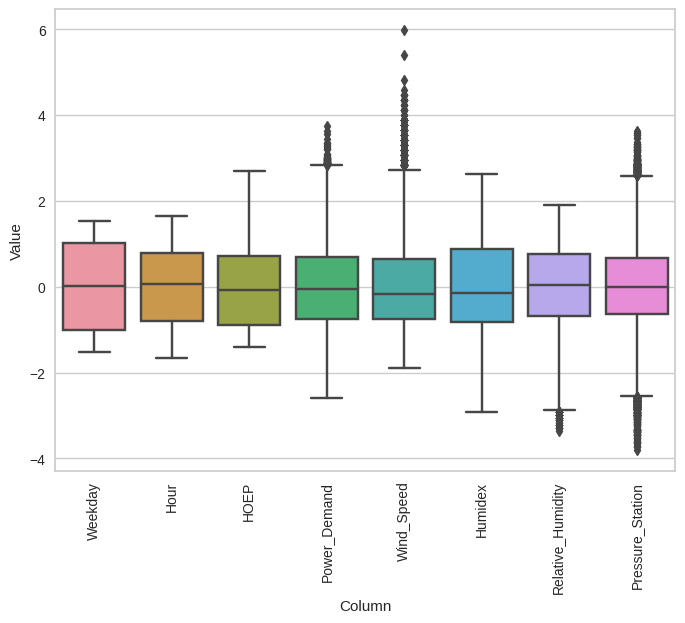

In [ ]:
check_outliers_boxplot(df_ifo)

After EDA the data is ready to do machine learning. Correlated features are dropped and outlier data points are removed.

In [ ]:
print(df_clean.shape)
print(df_clean.columns)
df_clean.head()

(37693, 9)
Index(['Date', 'Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed',
       'Humidex', 'Relative_Humidity', 'Pressure_Station'],
      dtype='object')


,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,4,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,4,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,4,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,4,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,4,13,0.00,14443,19,-5.09,84,99.35


**Data Enrichment**

In [208]:
df_enriched = df_clean.copy()

In [209]:
# create datetime onject based on date and hour
def combine_date_hour(row):
  return row['Date'] + pd.Timedelta(row['Hour'],'h') 

In [210]:
df_enriched['Date_Time']= df_enriched.apply(combine_date_hour,axis=1)
df_enriched.drop(columns=['Date'], inplace=True)
df_enriched.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Date_Time
0,4,0,0.49,14023,20,-3.18,70,99.67,2016-01-01 00:00:00
1,4,1,-1.09,13417,25,-3.48,68,99.63,2016-01-01 01:00:00
2,4,2,-2.41,12968,26,-3.43,73,99.59,2016-01-01 02:00:00
3,4,12,0.00,14215,23,-4.86,76,99.39,2016-01-01 12:00:00
4,4,13,0.00,14443,19,-5.09,84,99.35,2016-01-01 13:00:00


In [211]:
df_enriched.columns

Index(['Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed', 'Humidex',
       'Relative_Humidity', 'Pressure_Station', 'Date_Time'],
      dtype='object')

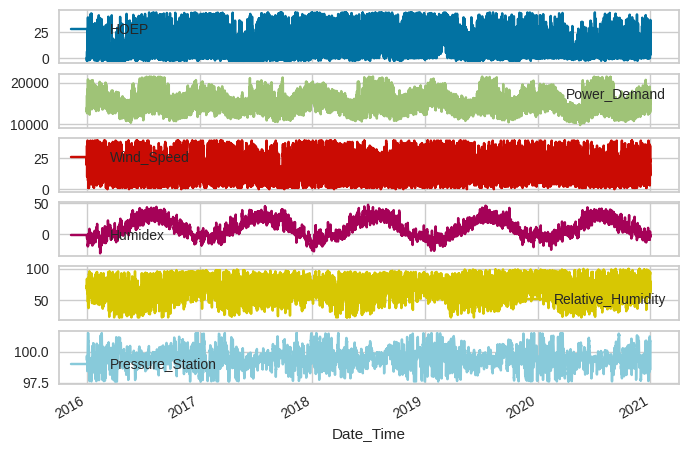

In [212]:
plot_cols = ['HOEP', 'Power_Demand', 'Wind_Speed',
       'Humidex', 'Relative_Humidity', 'Pressure_Station']

plot_features = df_enriched[plot_cols]
plot_features.index = df_enriched['Date_Time']
_ = plot_features.plot(subplots=True)

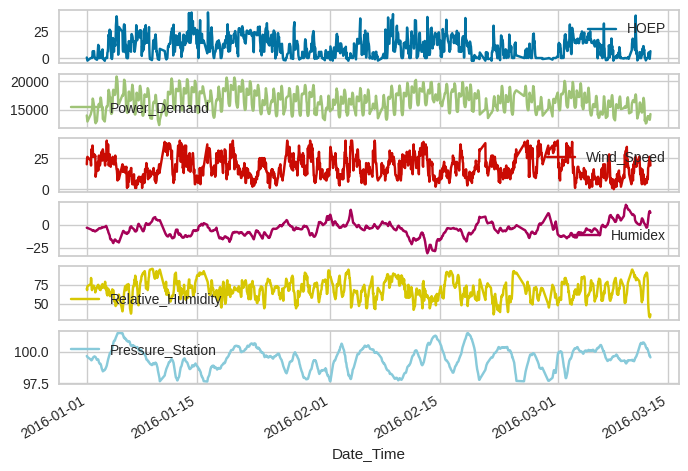

In [213]:
plot_features = df_enriched[plot_cols][:1440]
plot_features.index = df_enriched['Date_Time'][:1440]
_ = plot_features.plot(subplots=True)

array([<Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>],
      dtype=object)

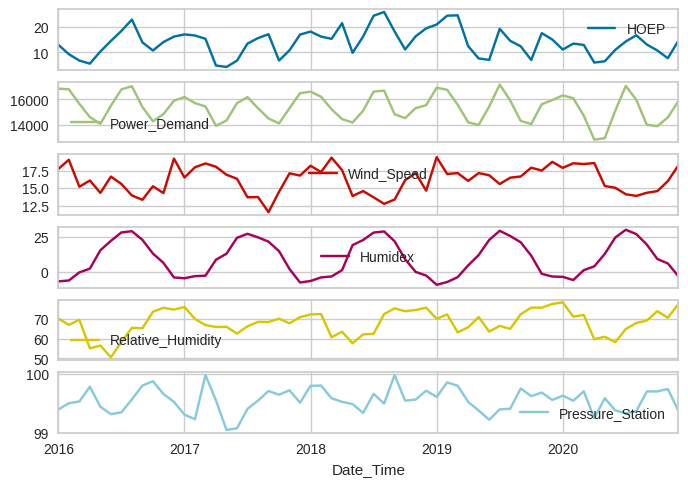

In [214]:
df_enriched.set_index('Date_Time', inplace=False).drop(columns=['Hour', 'Weekday']).resample('M').mean().plot(subplots=True)

In [215]:
df_enriched.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Weekday,37693.0,2.978033,1.989291,0.00,1.00,3.00,5.00,6.00
Hour,37693.0,11.566047,6.979988,0.00,6.00,12.00,18.00,23.00
HOEP,37693.0,13.999153,11.869356,-2.77,3.47,13.01,22.56,44.11
Power_Demand,37693.0,15356.846921,2171.683437,9831.00,13745.00,15239.00,16846.00,21536.00
Wind_Speed,37693.0,16.171491,8.256384,0.00,10.00,15.00,22.00,39.00
Humidex,37693.0,10.096934,14.217837,-31.10,-1.49,8.41,22.57,47.27
Relative_Humidity,37693.0,68.205370,16.613413,22.00,57.00,69.00,81.00,100.00
Pressure_Station,37693.0,99.555992,0.721508,97.61,99.09,99.55,100.04,101.52


In [216]:
df_enriched.isnull().sum()

Weekday              0
Hour                 0
HOEP                 0
Power_Demand         0
Wind_Speed           0
Humidex              0
Relative_Humidity    0
Pressure_Station     0
Date_Time            0
dtype: int64

In [217]:
df_enriched.columns

Index(['Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed', 'Humidex',
       'Relative_Humidity', 'Pressure_Station', 'Date_Time'],
      dtype='object')

In [219]:
df_enriched['Year'] = df_enriched['Date_Time'].dt.year
df_enriched['Month'] = df_enriched['Date_Time'].dt.month
df_enriched['Season'] = df_enriched['Date_Time'].dt.month % 12 // 3 + 1
df_enriched['Day'] = df_enriched['Date_Time'].dt.day
df_enriched['DayofYear'] = df_enriched['Date_Time'].dt.dayofyear

In [221]:
df_enriched.tail()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Date_Time,Year,Month,Season,Day,DayofYear
39403,3,19,36.85,17384,13,-2.69,74,100.66,2020-12-31 19:00:00,2020,12,1,31,366
39404,3,20,19.69,16783,16,-3.58,65,100.76,2020-12-31 20:00:00,2020,12,1,31,366
39405,3,21,20.78,16154,12,-3.67,80,100.81,2020-12-31 21:00:00,2020,12,1,31,366
39406,3,22,27.85,15744,17,-4.11,70,100.90,2020-12-31 22:00:00,2020,12,1,31,366
39407,3,23,19.68,15092,11,-4.72,73,100.90,2020-12-31 23:00:00,2020,12,1,31,366


In [222]:
df_enriched.duplicated(subset=['Date_Time']).sum()

3

In [223]:
# remove duplicate indexes
df_enriched.drop_duplicates(subset=['Date_Time'], inplace=True)

In [224]:
start_date = df_enriched['Date_Time'].min()
end_date = df_enriched['Date_Time'].max()

df_enriched.set_index(['Date_Time'], inplace=True)
df_enriched

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Year,Month,Season,Day,DayofYear
Date_Time,,,,,,,,,,,,,
2016-01-01 00:00:00,4,0,0.49,14023,20,-3.18,70,99.67,2016,1,1,1,1
2016-01-01 01:00:00,4,1,-1.09,13417,25,-3.48,68,99.63,2016,1,1,1,1
2016-01-01 02:00:00,4,2,-2.41,12968,26,-3.43,73,99.59,2016,1,1,1,1
2016-01-01 12:00:00,4,12,0.00,14215,23,-4.86,76,99.39,2016,1,1,1,1
2016-01-01 13:00:00,4,13,0.00,14443,19,-5.09,84,99.35,2016,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,3,19,36.85,17384,13,-2.69,74,100.66,2020,12,1,31,366
2020-12-31 20:00:00,3,20,19.69,16783,16,-3.58,65,100.76,2020,12,1,31,366
2020-12-31 21:00:00,3,21,20.78,16154,12,-3.67,80,100.81,2020,12,1,31,366


In [225]:
# complete the time series, fill the missing datapoints with the nearest available point 
df_enriched = df_enriched.reindex(pd.date_range(start_date, end_date, freq='H'), method='nearest')

In [226]:
df_enriched.shape

(43848, 13)

In [227]:
# demand data has clear daily and yearly periodicity
# get signals by using sine and cosine transforms of time to create "Time of day" and "Time of year" signals
date_time = df_enriched.index
timestamp_s = date_time.map(pd.Timestamp.timestamp)

day = 24*60*60
year = (365.2425)*day

df_enriched['day_sin'] = np.sin(timestamp_s * (2 * np.pi / day))
df_enriched['day_cos'] = np.cos(timestamp_s * (2 * np.pi / day))
df_enriched['year_sin'] = np.sin(timestamp_s * (2 * np.pi / year))
df_enriched['year_cos'] = np.cos(timestamp_s * (2 * np.pi / year))

Text(0.5, 1.0, 'Time of day signal')

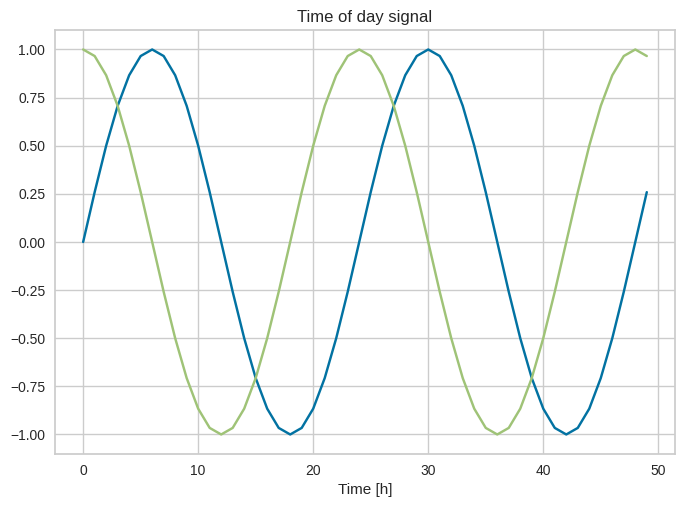

In [228]:
plt.plot(np.array(df_enriched['day_sin'])[:50])
plt.plot(np.array(df_enriched['day_cos'])[:50])
plt.xlabel('Time [h]')
plt.title('Time of day signal')

Text(0.5, 1.0, 'Time of day signal')

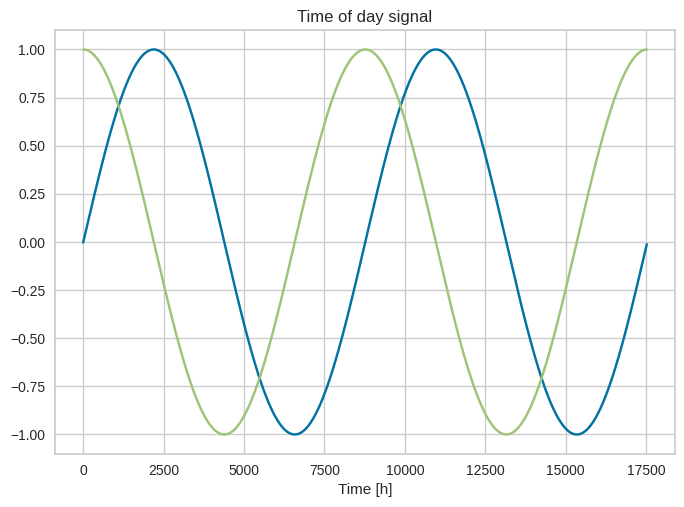

In [229]:
plt.plot(np.array(df_enriched['year_sin'])[:17520])
plt.plot(np.array(df_enriched['year_cos'])[:17520])
plt.xlabel('Time [h]')
plt.title('Time of day signal')

In [230]:
df_enriched.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Year,Month,Season,Day,DayofYear,day_sin,day_cos,year_sin,year_cos
2016-01-01 00:00:00,4,0,0.49,14023,20,-3.18,70,99.67,2016,1,1,1,1,-1.407890e-12,1.000000,-0.002666,0.999996
2016-01-01 01:00:00,4,1,-1.09,13417,25,-3.48,68,99.63,2016,1,1,1,1,2.588190e-01,0.965926,-0.001950,0.999998
2016-01-01 02:00:00,4,2,-2.41,12968,26,-3.43,73,99.59,2016,1,1,1,1,5.000000e-01,0.866025,-0.001233,0.999999
2016-01-01 03:00:00,4,2,-2.41,12968,26,-3.43,73,99.59,2016,1,1,1,1,7.071068e-01,0.707107,-0.000516,1.000000
2016-01-01 04:00:00,4,2,-2.41,12968,26,-3.43,73,99.59,2016,1,1,1,1,8.660254e-01,0.500000,0.000201,1.000000


In [231]:
print(df_enriched.shape)
columns_list = df_enriched.columns
print(columns_list)

(43848, 17)
Index(['Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed', 'Humidex',
       'Relative_Humidity', 'Pressure_Station', 'Year', 'Month', 'Season',
       'Day', 'DayofYear', 'day_sin', 'day_cos', 'year_sin', 'year_cos'],
      dtype='object')


In [232]:
# selected_columns = ['Power_Demand', 'HOEP', 'Wind_Speed', 'Humidex',
#                     'Relative_Humidity', 'Pressure_Station', 'year_sin',
#                     'Season','Weekday', 'day_sin']

selected_columns = ['Power_Demand', 'HOEP', 'Wind_Speed', 'Humidex','Relative_Humidity', 'Pressure_Station',
                    'DayofYear', 'Season','Weekday', 'Day', 'Hour']

In [233]:
df_selected = df_enriched[selected_columns]
df_selected

,Power_Demand,HOEP,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,DayofYear,Season,Weekday,Day,Hour
2016-01-01 00:00:00,14023,0.49,20,-3.18,70,99.67,1,1,4,1,0
2016-01-01 01:00:00,13417,-1.09,25,-3.48,68,99.63,1,1,4,1,1
2016-01-01 02:00:00,12968,-2.41,26,-3.43,73,99.59,1,1,4,1,2
2016-01-01 03:00:00,12968,-2.41,26,-3.43,73,99.59,1,1,4,1,2
2016-01-01 04:00:00,12968,-2.41,26,-3.43,73,99.59,1,1,4,1,2
...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,17384,36.85,13,-2.69,74,100.66,366,1,3,31,19
2020-12-31 20:00:00,16783,19.69,16,-3.58,65,100.76,366,1,3,31,20
2020-12-31 21:00:00,16154,20.78,12,-3.67,80,100.81,366,1,3,31,21
2020-12-31 22:00:00,15744,27.85,17,-4.11,70,100.90,366,1,3,31,22


Generally, we can classify time series forecasting problems into two categories:

1. Univariate: Involving a single time-dependent variable.
2. Multivariate: Involving more than one time-dependent variable.

In this particular case, the problem at hand is a multivariate time series prediction. I will explore various methods ranging from simple to advanced and assess their performance.

Here are the different approaches I will consider:

1.   Classical/Statistical Models : Fbprophet  
2.   Regression Models : Linear Regression, XGBoost, Random Forest.
3. Deep Learning Models: RNN, LSTM


**Reggression Model**

In regression methods, time series data can be viewed as observations and labels, making it suitable for fitting regression models. it means we are not considering time depencecies. this will be used as a baseline for our work.

In [181]:
from pycaret.regression import *

Adding time related features to the data and remove the date column itself.

In [234]:
df_reg = df_selected.copy()

In [235]:
df_reg.reset_index(inplace=True, drop=True)

In [236]:
df_reg.tail()

,Power_Demand,HOEP,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,DayofYear,Season,Weekday,Day,Hour
43843,17384,36.85,13,-2.69,74,100.66,366,1,3,31,19
43844,16783,19.69,16,-3.58,65,100.76,366,1,3,31,20
43845,16154,20.78,12,-3.67,80,100.81,366,1,3,31,21
43846,15744,27.85,17,-4.11,70,100.90,366,1,3,31,22
43847,15092,19.68,11,-4.72,73,100.90,366,1,3,31,23


In [237]:
# split dataset to train and test
n = len(df_reg)
df_reg_train = df_reg[0:int(n*0.8)]
df_reg_test = df_reg[int(n*0.8):]

num_features = df_reg.shape[1]

In [238]:
# initialize setup
pycaret_reg = setup(data=df_reg_train, test_data=df_reg_test, index=False, target='Power_Demand', fold_strategy='timeseries'
,         fold=3, transform_target=True, normalize=True, transformation=True, session_id=345)

,Description,Value
0,Session id,345
1,Target,Power_Demand
2,Target type,Regression
3,Original data shape,"(43848, 11)"
4,Transformed data shape,"(43848, 11)"
5,Transformed train set shape,"(35078, 11)"
6,Transformed test set shape,"(8770, 11)"
7,Numeric features,10
8,Preprocess,True
9,Imputation type,simple


In [239]:
pycaret_reg.get_config('X_train')

,HOEP,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,DayofYear,Season,Weekday,Day,Hour
0,0.49,20,-3.18,70,99.669998,1,1,4,1,0
1,-1.09,25,-3.48,68,99.629997,1,1,4,1,1
2,-2.41,26,-3.43,73,99.589996,1,1,4,1,2
3,-2.41,26,-3.43,73,99.589996,1,1,4,1,2
4,-2.41,26,-3.43,73,99.589996,1,1,4,1,2
...,...,...,...,...,...,...,...,...,...,...
35073,0.00,11,-4.39,80,98.459999,1,1,2,1,9
35074,0.00,16,-3.25,82,98.550003,1,1,2,1,10
35075,0.00,18,-3.56,80,98.589996,1,1,2,1,11
35076,0.00,24,-3.43,73,98.559998,1,1,2,1,12


In [240]:
pycaret_reg.get_config('y_train')

0        14023
1        13417
2        12968
3        12968
4        12968
         ...  
35073    13406
35074    13765
35075    14078
35076    14373
35077    14495
Name: Power_Demand, Length: 35078, dtype: int32

In [241]:
best_reg = compare_models(sort = 'MAE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,460.0129,372378.0285,604.4115,0.9156,0.0390,0.0301,0.7933
xgboost,Extreme Gradient Boosting,483.3424,416223.6830,636.1195,0.9053,0.0409,0.0315,1.7033
et,Extra Trees Regressor,507.5956,449799.2637,667.0038,0.8985,0.0429,0.0331,5.8800
rf,Random Forest Regressor,513.9282,466439.1395,677.6924,0.8945,0.0435,0.0335,11.0700
gbr,Gradient Boosting Regressor,517.6843,453221.7993,670.8387,0.8982,0.0434,0.0339,3.6733
dt,Decision Tree Regressor,694.9687,865900.4112,924.3834,0.8046,0.0595,0.0453,0.3100
ada,AdaBoost Regressor,769.3344,912115.3135,955.0233,0.7975,0.0614,0.0499,1.4467
knn,K Neighbors Regressor,905.6682,1356975.7416,1161.6567,0.6961,0.0751,0.0595,0.8567
br,Bayesian Ridge,1068.9904,1777732.5842,1332.7043,0.6058,0.0863,0.0707,0.2800
ridge,Ridge Regression,1069.0849,1778111.9723,1332.8485,0.6057,0.0863,0.0707,0.1700


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

In [242]:
# best = lightgbm
predictions_test = predict_model(best_reg, data=df_reg_test)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,626.4642,641721.2132,801.0750,0.8904,0.0553,0.0437


In [243]:
predictions_test

,HOEP,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,DayofYear,Season,Weekday,Day,Hour,Power_Demand,prediction_label
0,1.800000,15,-4.24,66,98.559998,1,1,2,1,14,9.311376,14531.721750
1,0.000000,17,-4.08,64,98.589996,1,1,2,1,15,9.322817,14435.039406
2,0.000000,15,-4.39,65,98.629997,1,1,2,1,16,9.326856,14351.926505
3,1.390000,14,-4.47,66,98.730003,1,1,2,1,17,9.372854,15229.987156
4,5.440000,14,-5.39,70,98.739998,1,1,2,1,18,9.422322,16728.027175
...,...,...,...,...,...,...,...,...,...,...,...,...
8765,36.849998,13,-2.69,74,100.660004,366,1,3,31,19,9.481648,17651.262492
8766,19.690001,16,-3.58,65,100.760002,366,1,3,31,20,9.448473,16935.418838
8767,20.780001,12,-3.67,80,100.809998,366,1,3,31,21,9.412448,16862.123167
8768,27.850000,17,-4.11,70,100.900002,366,1,3,31,22,9.388198,16443.378189


In [244]:
tuned_best_reg = tune_model(best_reg, optimize = 'MSE')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,698.2521,787396.7096,887.3538,0.8067,0.0592,0.0472
1,704.4944,790876.9195,889.3126,0.8351,0.0571,0.0458
2,531.6905,473125.9206,687.8415,0.8994,0.0433,0.0341
Mean,644.8123,683799.8499,821.5026,0.8471,0.0532,0.0423
Std,80.0298,148975.7393,94.5161,0.0388,0.0070,0.0059


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [245]:
evaluate_model(best_reg)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

**RNN Based - LSTM**

Now we will use RNN model for timeseries predicition. 


**Single output LSTM**

predict just one hour in future

In [ ]:
df_input = df_c.reset_index(drop=True)

In [ ]:
df_input

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
0,4,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67,-1.407890e-12,1.000000,-0.002666,0.999996
1,4,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63,2.588190e-01,0.965926,-0.001950,0.999998
2,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,5.000000e-01,0.866025,-0.001233,0.999999
3,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,7.071068e-01,0.707107,-0.000516,1.000000
4,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,8.660254e-01,0.500000,0.000201,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43843,3,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66,-9.659258e-01,0.258819,0.007297,0.999973
43844,3,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76,-8.660254e-01,0.500000,0.008014,0.999968
43845,3,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81,-7.071068e-01,0.707107,0.008730,0.999962
43846,3,27.85,15744,-0.8,-6.76,17,-4.11,70,-5.6,100.90,-5.000000e-01,0.866025,0.009447,0.999955


In [ ]:
#df_input.drop(columns=['ds'], inplace=True)
#df_input

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(df_input)

In [ ]:
data_scaled

array([[0.66666667, 0.06953925, 0.29010381, ..., 1.        , 0.49866679,
        0.99999822],
       [0.66666667, 0.03583618, 0.24816609, ..., 0.98296291, 0.49902518,
        0.99999905],
       [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 , 0.49938357,
        0.99999962],
       ...,
       [0.5       , 0.50234642, 0.43757785, ..., 0.85355339, 0.50436515,
        0.99998095],
       [0.5       , 0.653157  , 0.40920415, ..., 0.9330127 , 0.50472353,
        0.99997769],
       [0.5       , 0.47888225, 0.36408304, ..., 0.98296291, 0.5050819 ,
        0.99997417]])

In [ ]:
features=data_scaled
target=data_scaled[:, 2]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=123, shuffle=False)

In [ ]:
from keras.preprocessing.sequence import TimeseriesGenerator
window_length = 72
batch_size = 32
train_generator = TimeseriesGenerator(x_train, y_train, length=window_length, sampling_rate=1, batch_size=batch_size)
test_generator = TimeseriesGenerator(x_test, y_test, length=window_length, sampling_rate=1, batch_size=batch_size)

In [ ]:
train_generator[0]

(array([[[0.66666667, 0.06953925, 0.29010381, ..., 1.        ,
          0.49866679, 0.99999822],
         [0.66666667, 0.03583618, 0.24816609, ..., 0.98296291,
          0.49902518, 0.99999905],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 ,
          0.49938357, 0.99999962],
         ...,
         [1.        , 0.54180887, 0.56574394, ..., 0.85355339,
          0.52338724, 0.99945274],
         [1.        , 0.62841297, 0.52013841, ..., 0.9330127 ,
          0.52374523, 0.99943585],
         [1.        , 0.37137372, 0.46885813, ..., 0.98296291,
          0.52410321, 0.9994187 ]],
 
        [[0.66666667, 0.03583618, 0.24816609, ..., 0.98296291,
          0.49902518, 0.99999905],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 ,
          0.49938357, 0.99999962],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.85355339,
          0.49974196, 0.99999993],
         ...,
         [1.        , 0.62841297, 0.52013841, ..., 0.9330127 ,
          0.52374523, 0.

In [ ]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.LSTM(128, input_shape=(window_length, num_features), return_sequences=True))
model.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model.add(tf.keras.layers.LSTM(128, return_sequences=True))
model.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model.add(tf.keras.layers.Dropout(0.3))
model.add(tf.keras.layers.LSTM(64, return_sequences=False))
model.add(tf.keras.layers.Dropout(0.3))
model.add(tf.keras.layers.Dense(1))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 72, 128)           73216     
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 72, 128)           0         
                                                                 
 lstm_1 (LSTM)               (None, 72, 128)           131584    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 72, 128)           0         
                                                                 
 dropout (Dropout)           (None, 72, 128)           0         
                                                                 
 lstm_2 (LSTM)               (None, 64)                49408     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=2,
                                                  mode='min')

model.compile(loss=tf.keras.losses.MeanSquaredError(),
              optimizer=tf.keras.optimizers.Adam(),
              metrics=[tf.keras.metrics.MeanAbsoluteError(),
                        tf.keras.metrics.MeanAbsolutePercentageError()])

history = model.fit_generator(train_generator, epochs=10,
                    validation_data=test_generator,
                    shuffle=False,
                    callbacks=[early_stopping])

Epoch 1/10


<ipython-input-23-f49d3c678385>:10: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(train_generator, epochs=10,


1094/1094 [==============================] - 356s 314ms/step - loss: 0.0106 - mean_absolute_error: 0.0775 - mean_absolute_percentage_error: 22.3208 - val_loss: 0.0150 - val_mean_absolute_error: 0.0951 - val_mean_absolute_percentage_error: 22792.6113
Epoch 2/10
1094/1094 [==============================] - 365s 333ms/step - loss: 0.0052 - mean_absolute_error: 0.0553 - mean_absolute_percentage_error: 15.9771 - val_loss: 0.0105 - val_mean_absolute_error: 0.0805 - val_mean_absolute_percentage_error: 17244.5312
Epoch 3/10
1094/1094 [==============================] - 359s 328ms/step - loss: 0.0036 - mean_absolute_error: 0.0461 - mean_absolute_percentage_error: 13.4248 - val_loss: 0.0071 - val_mean_absolute_error: 0.0666 - val_mean_absolute_percentage_error: 12726.8896
Epoch 4/10
1094/1094 [==============================] - 340s 310ms/step - loss: 0.0025 - mean_absolute_error: 0.0380 - mean_absolute_percentage_error: 11.1568 - val_loss: 0.0060 - val_mean_absolute_error: 0.0602 - val_mean_absol

In [ ]:
predictions = model.predict(test_generator)

272/272 [==============================] - 42s 139ms/step


In [ ]:
predictions.shape

(8698, 1)

In [ ]:
y_test.shape

(8770,)

In [ ]:
x_test.shape

(8770, 14)

In [ ]:
df_pred = pd.concat([pd.DataFrame(predictions), pd.DataFrame(x_test[window_length:])], axis=1)

In [ ]:
df_pred.head()
print(df_pred[2].shape)
print(df_pred[0].shape)

(8698,)
(8698, 2)


In [ ]:
df_pred[0].head()

,0,0
0,0.404725,0.833333
1,0.406282,0.833333
2,0.413150,0.833333
3,0.433860,0.833333
4,0.474015,0.833333


In [ ]:
df_pred.drop([2], inplace=True)
df_pred.head()

,0,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,0.404725,0.833333,0.504693,0.435433,0.461538,0.461469,0.3125,0.375322,0.632184,0.504409,0.347973,0.250000,0.066987,0.529729,0.999115
1,0.406282,0.833333,0.343430,0.432595,0.458265,0.471005,0.2625,0.379251,0.655172,0.506173,0.353041,0.146447,0.146447,0.530087,0.999094
3,0.433860,0.833333,0.161476,0.471211,0.450082,0.459536,0.2875,0.364641,0.620690,0.486772,0.366554,0.017037,0.370590,0.530802,0.999050
4,0.474015,0.833333,0.343857,0.515017,0.441899,0.463660,0.2250,0.367342,0.724138,0.507937,0.381757,0.000000,0.500000,0.531160,0.999028
5,0.502976,0.833333,0.263865,0.488166,0.438625,0.454897,0.2500,0.360344,0.735632,0.506173,0.391892,0.017037,0.629410,0.531518,0.999006


Multi Output LSTM

**Single Shot LSTM Model**

Make the predictions all at once.

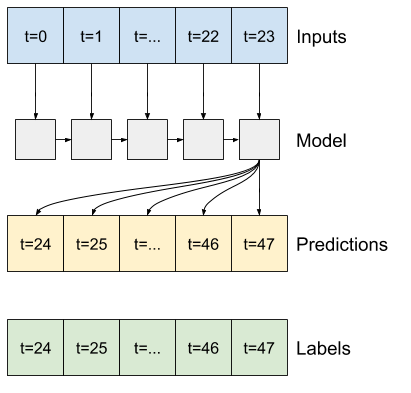

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/Colab Notebooks/CamrosTech/multistep_lstm.png'))

In [ ]:
# use a (70%, 20%, 10%) split for the training, validation, and test sets.
n = len(df_c)
train_df = df_c[0:int(n*0.7)]
val_df = df_c[int(n*0.7):int(n*0.9)]
test_df = df_c[int(n*0.9):]

In [ ]:
# normalize data
train_mean = train_df.mean()
train_std = train_df.std()

train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std
test_df = (test_df - train_mean) / train_std
train_df.head()

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
2016-01-01 00:00:00,0.499161,-1.048438,-0.665868,-0.822075,-0.833127,0.344657,-0.846949,0.163991,-0.731526,0.167482,-0.000068,1.414339,-0.133466,1.414088
2016-01-01 01:00:00,0.499161,-1.165250,-0.946238,-0.822075,-0.882036,0.867499,-0.867528,0.044746,-0.769187,0.116266,0.365944,1.366151,-0.132444,1.414090
2016-01-01 02:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.707012,1.224869,-0.131422,1.414092
2016-01-01 03:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.999894,1.000123,-0.130399,1.414093
2016-01-01 04:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,1.224630,0.707228,-0.129377,1.414093


In [ ]:
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# scaler.fit(train_df)
# train_scaled = scaler.transform(train_df)
# test_scaled = scaler.transform(test_df)
# scaled_val = scaler.transform(val_df)

# pd.DataFrame(train_scaled).head()

In [ ]:
train_df.head()

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
2016-01-01 00:00:00,0.499161,-1.048438,-0.665868,-0.822075,-0.833127,0.344657,-0.846949,0.163991,-0.731526,0.167482,-0.000068,1.414339,-0.133466,1.414088
2016-01-01 01:00:00,0.499161,-1.165250,-0.946238,-0.822075,-0.882036,0.867499,-0.867528,0.044746,-0.769187,0.116266,0.365944,1.366151,-0.132444,1.414090
2016-01-01 02:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.707012,1.224869,-0.131422,1.414092
2016-01-01 03:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.999894,1.000123,-0.130399,1.414093
2016-01-01 04:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,1.224630,0.707228,-0.129377,1.414093


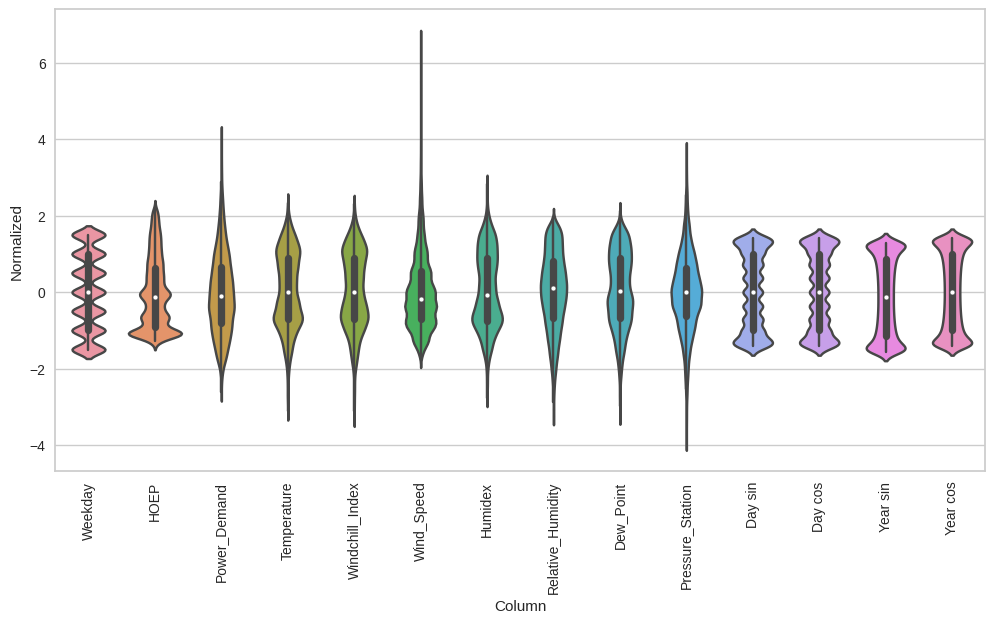

In [ ]:
# check features' distribution
df_std = (df_c - train_mean) / train_std
df_std = df_std.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(df_c.keys(), rotation=90)

In [ ]:
# data windowing - create dataset based on tensorflow dataset object, considering
# batch_size, length of timeseries and number of features

BATCH_SIZE = 16
class WindowGenerator():
  def __init__(self, input_width, label_width, shift,
               train_df=train_df, val_df=val_df, test_df=test_df,
               label_columns=None):
    # Store the raw data.
    self.train_df = train_df
    self.val_df = val_df
    self.test_df = test_df

    # Work out the label column indices.
    self.label_columns = label_columns
    if label_columns is not None:
      self.label_columns_indices = {name: i for i, name in
                                    enumerate(label_columns)}
    self.column_indices = {name: i for i, name in
                           enumerate(train_df.columns)}

    # Work out the window parameters.
    self.input_width = input_width
    self.label_width = label_width
    self.shift = shift

    self.total_window_size = input_width + shift

    self.input_slice = slice(0, input_width)
    self.input_indices = np.arange(self.total_window_size)[self.input_slice]

    self.label_start = self.total_window_size - self.label_width
    self.labels_slice = slice(self.label_start, None)
    self.label_indices = np.arange(self.total_window_size)[self.labels_slice]

  def __repr__(self):
    return '\n'.join([
        f'Total window size: {self.total_window_size}',
        f'Input indices: {self.input_indices}',
        f'Label indices: {self.label_indices}',
        f'Label column name(s): {self.label_columns}'])
    
  def split_window(self, features):
    inputs = features[:, self.input_slice, :]
    labels = features[:, self.labels_slice, :]
    if self.label_columns is not None:
      labels = tf.stack(
          [labels[:, :, self.column_indices[name]] for name in self.label_columns],
          axis=-1)

    # Slicing doesn't preserve static shape information, so set the shapes
    # manually. This way the `tf.data.Datasets` are easier to inspect.
    inputs.set_shape([None, self.input_width, None])
    labels.set_shape([None, self.label_width, None])

    return inputs, labels

  def plot(self, model=None, plot_col='Power_Demand', max_subplots=3):
    inputs, labels = self.example
    plt.figure(figsize=(12, 8))
    plot_col_index = self.column_indices[plot_col]
    max_n = min(max_subplots, len(inputs))
    for n in range(max_n):
      plt.subplot(max_n, 1, n+1)
      plt.ylabel(f'{plot_col} [normed]')
      plt.plot(self.input_indices, inputs[n, :, plot_col_index],
              label='Inputs', marker='.', zorder=-10)

      if self.label_columns:
        label_col_index = self.label_columns_indices.get(plot_col, None)
      else:
        label_col_index = plot_col_index

      if label_col_index is None:
        continue

      plt.scatter(self.label_indices, labels[n, :, label_col_index],
                  edgecolors='k', label='Labels', c='#2ca02c', s=64)
      if model is not None:
        predictions = model(inputs)
        plt.scatter(self.label_indices, predictions[n, :, label_col_index],
                    marker='X', edgecolors='k', label='Predictions',
                    c='#ff7f0e', s=64)

      if n == 0:
        plt.legend()

    plt.xlabel('Time [h]')

  def make_dataset(self, data):
    data = np.array(data, dtype=np.float32)
    ds = tf.keras.utils.timeseries_dataset_from_array(
        data=data,
        targets=None,
        sequence_length=self.total_window_size,
        sequence_stride=1,
        shuffle=True,
        batch_size=BATCH_SIZE,)

    ds = ds.map(self.split_window)

    return ds

  @property
  def train(self):
    return self.make_dataset(self.train_df)

  @property
  def val(self):
    return self.make_dataset(self.val_df)

  @property
  def test(self):
    return self.make_dataset(self.test_df)

  @property
  def example(self):
    """Get and cache an example batch of `inputs, labels` for plotting."""
    result = getattr(self, '_example', None)
    if result is None:
      # No example batch was found, so get one from the `.train` dataset
      result = next(iter(self.train))
      # And cache it for next time
      self._example = result
    return result


Total window size: 72
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label indices: [48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71]
Label column name(s): ['Power_Demand']

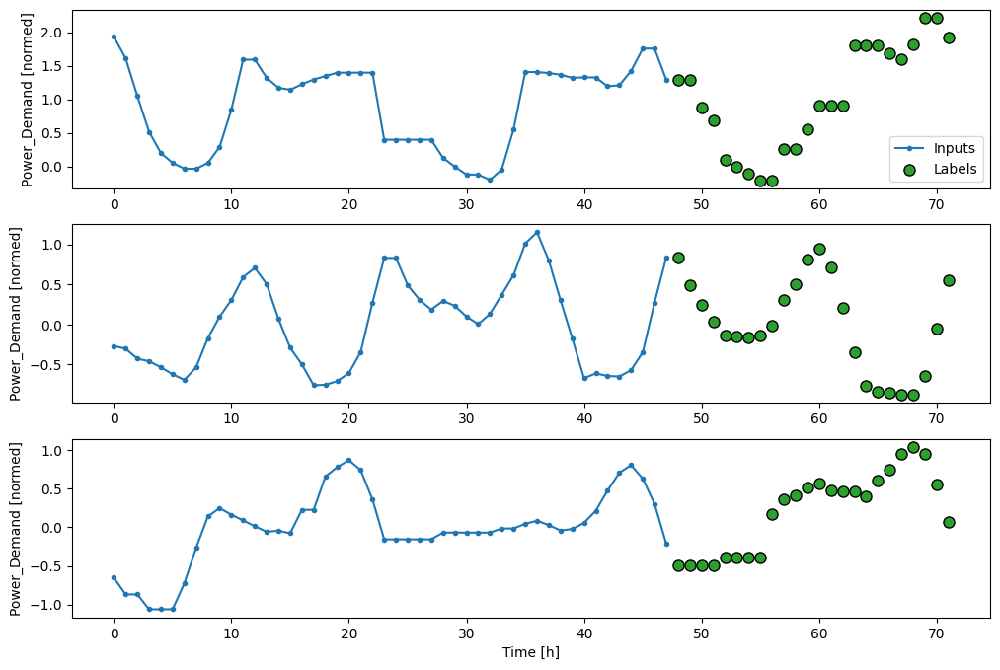

In [ ]:
# create window object for LSTM singleshot prediction 
OUT_STEPS = 24
dataset_ss = WindowGenerator(input_width=48,
                               label_width=OUT_STEPS,
                               shift=OUT_STEPS,
                               label_columns=['Power_Demand'])

dataset_ss.plot()
dataset_ss

In [ ]:
# training function
MAX_EPOCHS = 10

def compile_and_fit(model, window, patience=2):
  early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=patience,
                                                    mode='min')

  model.compile(loss=tf.keras.losses.MeanSquaredError(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=[tf.keras.metrics.MeanAbsoluteError(),
                         tf.keras.metrics.MeanAbsolutePercentageError()])

  history = model.fit(window.train, epochs=MAX_EPOCHS,
                      validation_data=window.val,
                      callbacks=[early_stopping])
  return history

In [ ]:
# check inputs shapes

print('Train data ->', dataset_ss.train_df.shape)
# print('Number of batches -> ', len(list(dataset_ss.train)))
print('input shape to LSTM ->', next(iter(dataset_ss.train.take(1)))[0].shape)
print('Number of batches -> ', tf.data.experimental.cardinality(dataset_ss.train).numpy())

Train data -> (30693, 14)
input shape to LSTM -> (16, 48, 14)
Number of batches ->  1914


544/544 [==============================] - 4s 8ms/step - loss: 0.1065 - mean_absolute_error: 0.2462 - mean_absolute_percentage_error: 92.8446


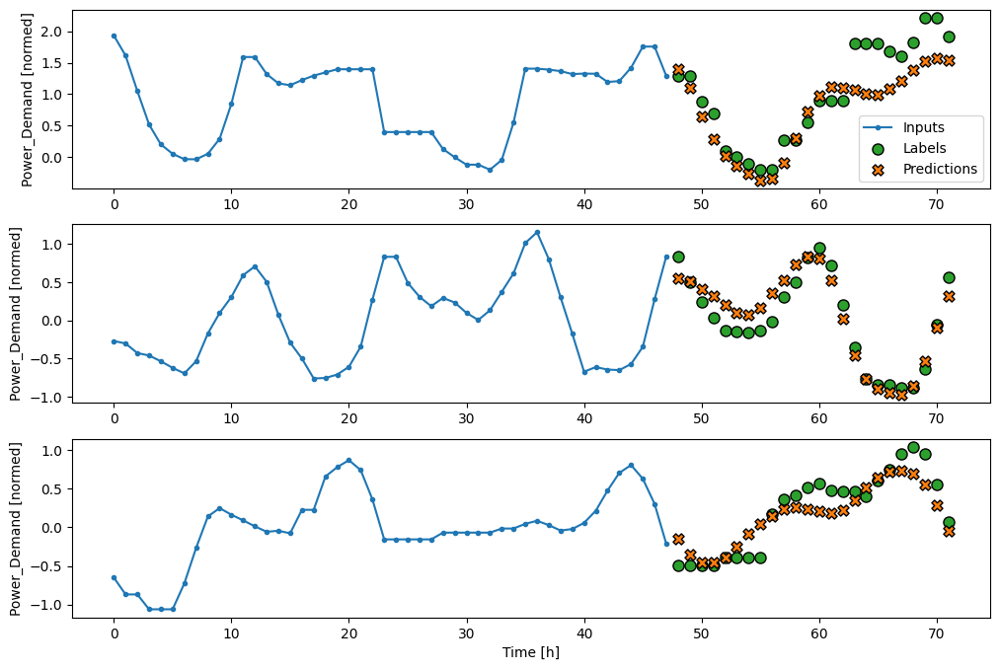

In [ ]:
# create LSTM model for singleshot(24 hours at on shot) prediction

lstm_singleshot = tf.keras.Sequential([
    # Shape [batch, time, features] => [batch, lstm_units].
    # Adding more `lstm_units` just overfits more quickly.
    tf.keras.layers.LSTM(50, return_sequences=False),
    # Shape => [batch, out_steps*features].
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features].
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

val_performance = {}
performance = {}

history = compile_and_fit(lstm_singleshot, dataset_ss)

IPython.display.clear_output()

val_performance['LSTM_singleshot'] = lstm_singleshot.evaluate(dataset_ss.val)
performance['LSTM_singleshot'] = lstm_singleshot.evaluate(dataset_ss.test, verbose=0)
dataset_ss.plot(lstm_singleshot)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
def mean_absolute_percentage_error(y_true, y_pred): 
    """Calculates MAPE given y_true and y_pred"""
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
from datetime import datetime
from datetime import timedelta
def predict_demand(datetime_str='2020-12-22 00:00:00', lookback=48):
  '''
    predict power demand for a sample date in the 'test dataset'
    lookback will configure the number of hours which model will look to generate the response
    - datetime_str in str %Y-%m-%d %H:%M:%S
    - lookback in hours
  '''
  date = datetime.strptime(datetime_str, '%Y-%m-%d %H:%M:%S')
  window = test_df.loc[date - timedelta(hours=lookback): date + timedelta(hours=24-1)]
  input = test_df.loc[date - timedelta(hours=lookback): date - timedelta(hours=1)]
  out = test_df.loc[date : date + timedelta(hours=23-1)]

  pred = lstm_singleshot.predict(np.array(input).reshape((1, lookback, 14)))
  pred_df = pd.DataFrame(pred.reshape((24,14)))

  y_prime = pred_df[pred_df.columns[2]]
  y_prime = pd.concat([input['Power_Demand'], y_prime], axis=0, ignore_index=True)

  y = window['Power_Demand']
  y.reset_index(drop=True)


  plt.plot(window.index, y_prime, label='Pred', marker='.', zorder=-10)
  plt.plot(window.index, y, label='True', marker='.',zorder=-10)
  plt.legend()
  plt.show()
  return mean_absolute_percentage_error(y.iloc[-lookback:], y_prime.iloc[-lookback:])

1/1 [==============================] - 0s 483ms/step


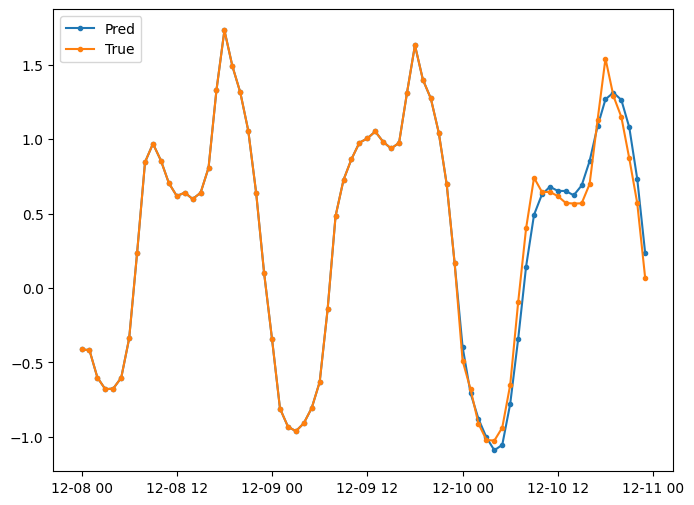

17.28623942860572

In [ ]:
predict_demand('2020-12-10 00:00:00')

In [ ]:
dataset_ss.test_df.shape

(4385, 14)

In [ ]:
res=lstm_singleshot.predict(dataset_ss.test)

270/270 [==============================] - 5s 12ms/step


In [ ]:
res.shape

(4314, 24, 14)

In [ ]:
#test_df.sort_index(inplace=True)
# sample_date = test_df.loc['2020-12-20 00:00:00': '2020-12-22 23:00:00']
# sample_in = sample_date.loc['2020-12-20 00:00:00': '2020-12-21 23:00:00']
# sample_out = sample_date.loc['2020-12-22 00:00:00': '2020-12-22 23:00:00']

**Autoregressive LSTM Model**

Make one prediction at a time and feed the output back to the model.


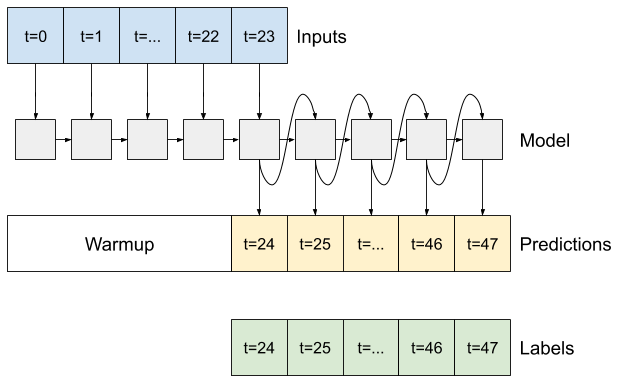

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/Colab Notebooks/CamrosTech/multistep_autoregressive.png'))

Total window size: 72
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label indices: [48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71]
Label column name(s): None

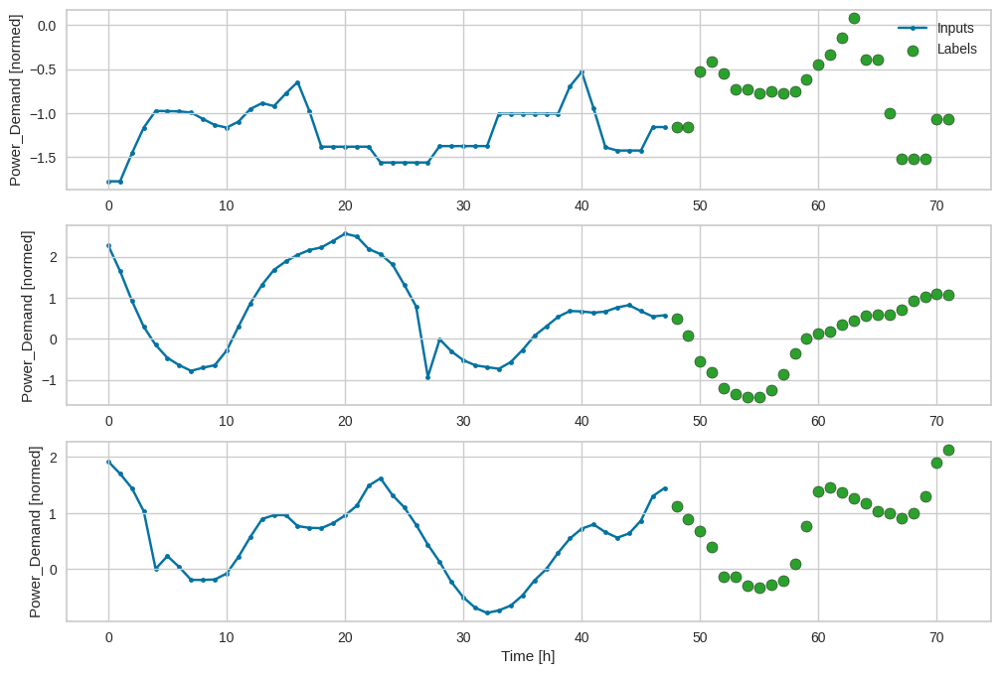

In [ ]:
# autoregressive lstm model
OUT_STEPS = 24
dataset_ar = WindowGenerator(input_width=48,
                               label_width=OUT_STEPS,
                               shift=OUT_STEPS)

dataset_ar.plot()
dataset_ar

In [ ]:
# feedback class
class FeedBack(tf.keras.Model):
  def __init__(self, units, out_steps):
    super().__init__()
    self.out_steps = out_steps
    self.units = units
    self.lstm_cell = tf.keras.layers.LSTMCell(units)
    # wrap the LSTMCell in an RNN to simplify the `warmup` method.
    self.lstm_rnn = tf.keras.layers.RNN(self.lstm_cell, return_state=True)
    self.dense = tf.keras.layers.Dense(num_features)

  def warmup(self, inputs):
    # inputs.shape => (batch, time, features)
    # x.shape => (batch, lstm_units)
    x, *state = self.lstm_rnn(inputs)

    # predictions.shape => (batch, features)
    prediction = self.dense(x)
    return prediction, state

  def call(self, inputs, training=None):
    # Use a TensorArray to capture dynamically unrolled outputs.
    predictions = []
    # Initialize the LSTM state.
    prediction, state = self.warmup(inputs)

    # Insert the first prediction.
    predictions.append(prediction)

    # Run the rest of the prediction steps.
    for n in range(1, self.out_steps):
      # Use the last prediction as input.
      x = prediction
      # Execute one lstm step.
      x, state = self.lstm_cell(x, states=state,
                                training=training)
      # Convert the lstm output to a prediction.
      prediction = self.dense(x)
      # Add the prediction to the output.
      predictions.append(prediction)

    # predictions.shape => (time, batch, features)
    predictions = tf.stack(predictions)
    # predictions.shape => (batch, time, features)
    predictions = tf.transpose(predictions, [1, 0, 2])
    
    return predictions

In [ ]:
feedback_model = FeedBack(units=50, out_steps=OUT_STEPS)

print('Train data ->', dataset_ar.train_df.shape)
print('input shape to LSTM ->', next(iter(dataset_ar.train.take(1)))[0].shape)
print('Number of batches -> ', tf.data.experimental.cardinality(dataset_ar.train).numpy())
print('Output shape (batch, time, features): ', feedback_model(dataset_ar.example[0]).shape)

Train data -> (30693, 14)
input shape to LSTM -> (16, 48, 14)
Number of batches ->  1914
Output shape (batch, time, features):  (16, 24, 14)


Epoch 1/20
1914/1914 [==============================] - 79s 37ms/step - loss: 0.2654 - mean_absolute_error: 0.3446 - mean_absolute_percentage_error: 1961.9822 - val_loss: 0.1926 - val_mean_absolute_error: 0.2868 - val_mean_absolute_percentage_error: 1645.7366
Epoch 2/20
1914/1914 [==============================] - 72s 38ms/step - loss: 0.1863 - mean_absolute_error: 0.2735 - mean_absolute_percentage_error: 1485.5413 - val_loss: 0.1762 - val_mean_absolute_error: 0.2645 - val_mean_absolute_percentage_error: 1342.8210
Epoch 3/20
1914/1914 [==============================] - 76s 40ms/step - loss: 0.1741 - mean_absolute_error: 0.2612 - mean_absolute_percentage_error: 1376.2921 - val_loss: 0.1781 - val_mean_absolute_error: 0.2663 - val_mean_absolute_percentage_error: 1423.3396
Epoch 4/20
1914/1914 [==============================] - 71s 37ms/step - loss: 0.1673 - mean_absolute_error: 0.2548 - mean_absolute_percentage_error: 1360.1964 - val_loss: 0.1741 - val_mean_absolute_error: 0.2603 - val_me

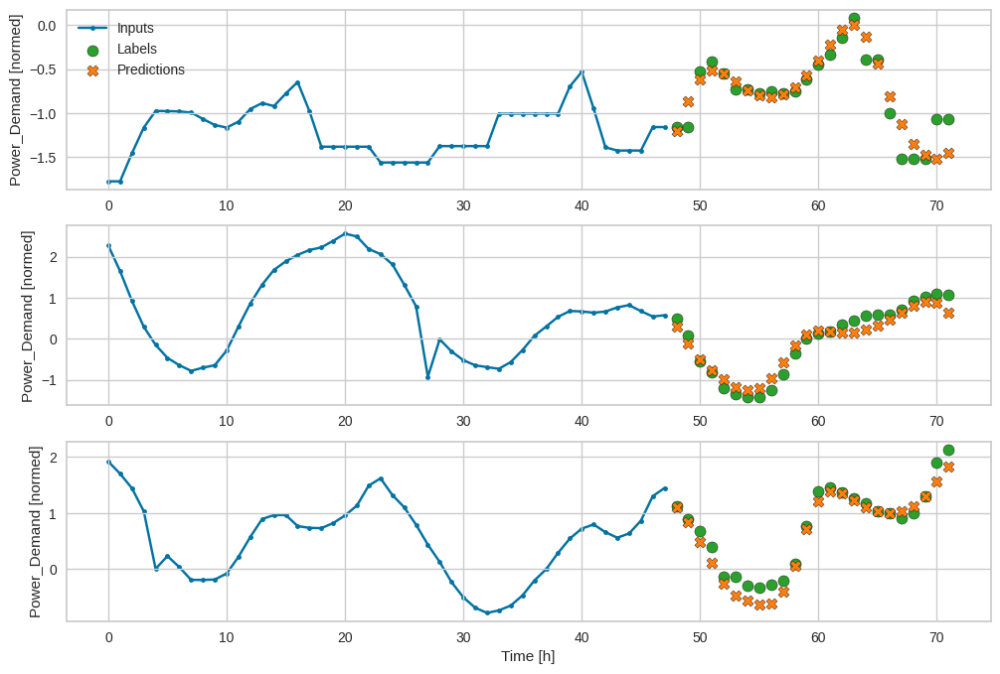

In [ ]:
history = compile_and_fit(feedback_model, dataset_ar)

val_performance['AR LSTM'] = feedback_model.evaluate(dataset_ar.val)
performance['AR LSTM'] = feedback_model.evaluate(dataset_ar.test, verbose=0)
dataset_ar.plot(feedback_model)

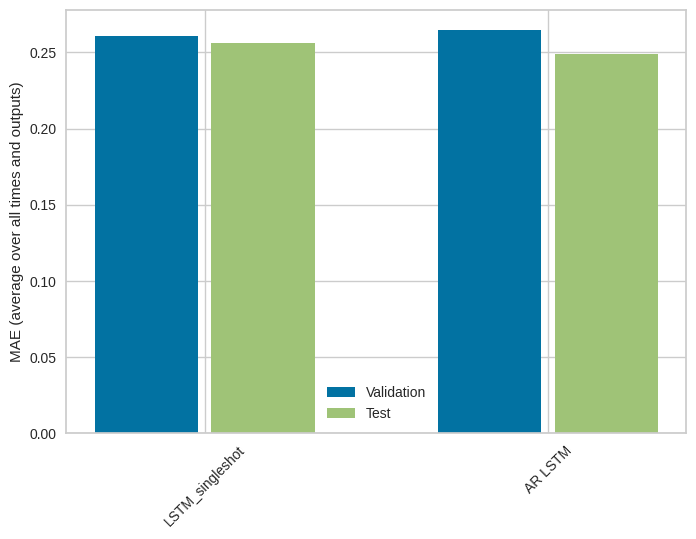

In [ ]:
x = np.arange(len(performance))
width = 0.3

metric_name = 'mean_absolute_error'
metric_index = lstm_singleshot.metrics_names.index('mean_absolute_error')
val_mae = [v[metric_index] for v in val_performance.values()]
test_mae = [v[metric_index] for v in performance.values()]

plt.bar(x - 0.17, val_mae, width, label='Validation')
plt.bar(x + 0.17, test_mae, width, label='Test')
plt.xticks(ticks=x, labels=performance.keys(),
           rotation=45)
plt.ylabel(f'MAE (average over all times and outputs)')
_ = plt.legend()

In [ ]:
# print('label columns:', window_singleshot.label_columns)
# print('label_columns_indices:', window_singleshot.label_columns_indices)
# print('label_indices:', window_singleshot.label_indices)
# print('label_start:', window_singleshot.label_start)
# print('label_width:', window_singleshot.label_width)
# print('column_indices:', window_singleshot.column_indices)

**Statistical Model**

In [ ]:
demand = df_c['Power_Demand']

<Axes: >

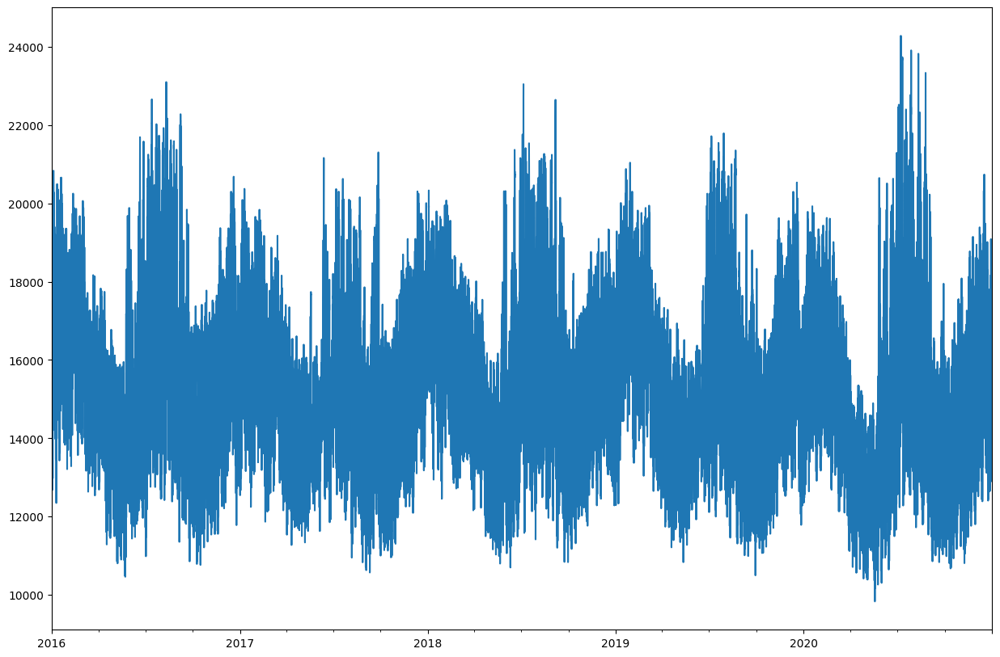

In [ ]:
demand.plot(figsize=(15,10))

array([<Axes: >], dtype=object)

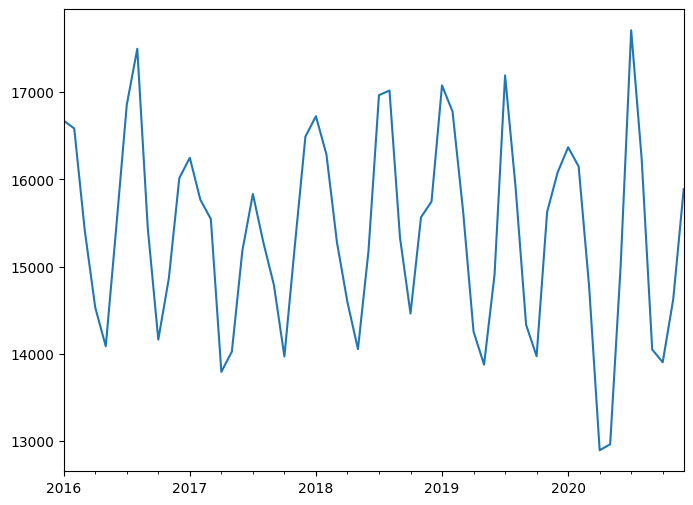

In [ ]:
demand.resample('M').mean().plot(subplots=True)

In [ ]:
from pycaret.time_series import *
s = setup(demand , fold = 3  , fh=24, session_id = 123)

,Description,Value
0,session_id,123
1,Target,Power_Demand
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(43848, 1)"
5,Transformed data shape,"(43848, 1)"
6,Transformed train set shape,"(43824, 1)"
7,Transformed test set shape,"(24, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [ ]:
plot_model(plot = 'decomp_classical')

In [ ]:
plot_model(plot = 'acf')

In [ ]:
plot_model(plot = 'pacf')

In [ ]:
from prophet import Prophet

In [ ]:
df_c['ds'] = df_c.index
demand = df_c[['ds','Power_Demand']].rename(columns={'Power_Demand': 'y'})

In [ ]:
demand.head()

,ds,y
2016-01-01 00:00:00,2016-01-01 00:00:00,14023
2016-01-01 01:00:00,2016-01-01 01:00:00,13417
2016-01-01 02:00:00,2016-01-01 02:00:00,12968
2016-01-01 03:00:00,2016-01-01 03:00:00,12968
2016-01-01 04:00:00,2016-01-01 04:00:00,12968


In [ ]:
n = len(demand)
train_demand = demand[0:int(n*0.9)]
test_demand = demand[int(n*0.9):]

In [ ]:
m = Prophet(interval_width=0.95, yearly_seasonality=True)
m.fit(train_demand)

DEBUG:cmdstanpy:input tempfile: /tmp/tmp93vk9zbf/ier5o16o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp93vk9zbf/qwkxwkby.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7566', 'data', 'file=/tmp/tmp93vk9zbf/ier5o16o.json', 'init=/tmp/tmp93vk9zbf/qwkxwkby.json', 'output', 'file=/tmp/tmp93vk9zbf/prophet_modeldw7csawa/prophet_model-20230601173214.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:32:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:33:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
forecast = m.predict(test_demand)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
4380,2020-12-31 19:00:00,18326.324119,12540.793278,23795.708777
4381,2020-12-31 20:00:00,18447.607125,12697.336784,23831.891944
4382,2020-12-31 21:00:00,18195.229206,12327.628920,23737.175347
4383,2020-12-31 22:00:00,17545.092690,11654.339302,22907.728501
4384,2020-12-31 23:00:00,16642.683606,10824.754397,22190.632359


In [ ]:
future = m.make_future_dataframe(periods=100)

In [ ]:
future.shape

(39563, 1)

In [ ]:
forecast_1 = m.predict(future)

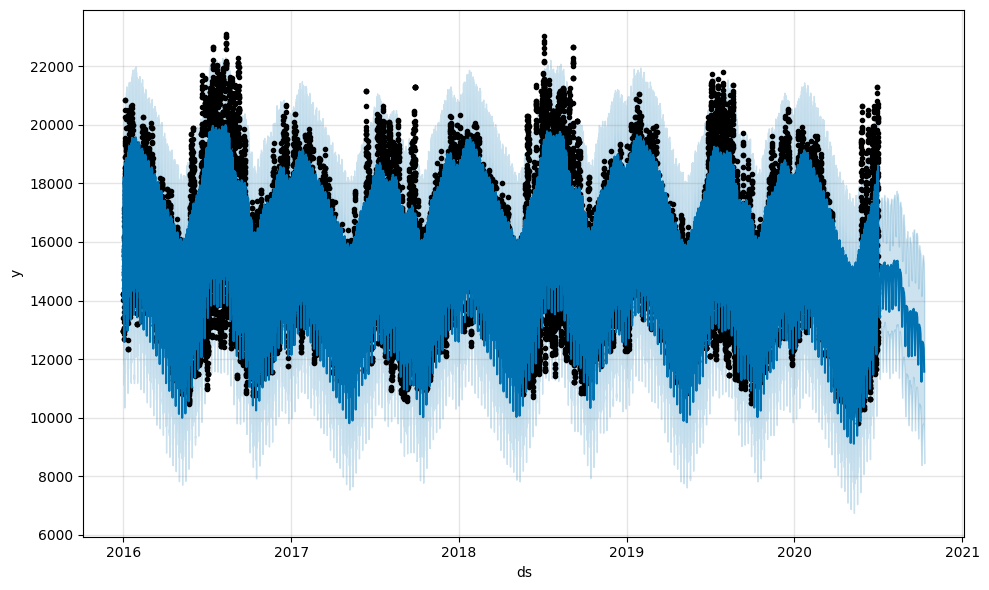

In [ ]:
fig = m.plot(forecast_1)

In [ ]:
from prophet.plot import plot_plotly
import plotly.offline as py

fig = plot_plotly(m, forecast_1)
py.iplot(fig)

NameError: ignored

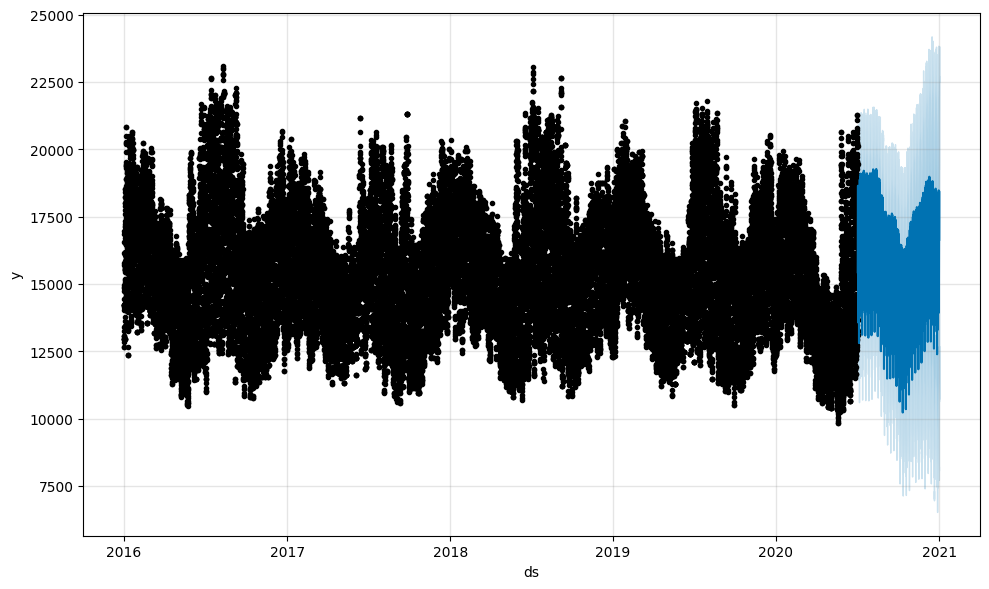

In [ ]:
fig = m.plot(forecast)

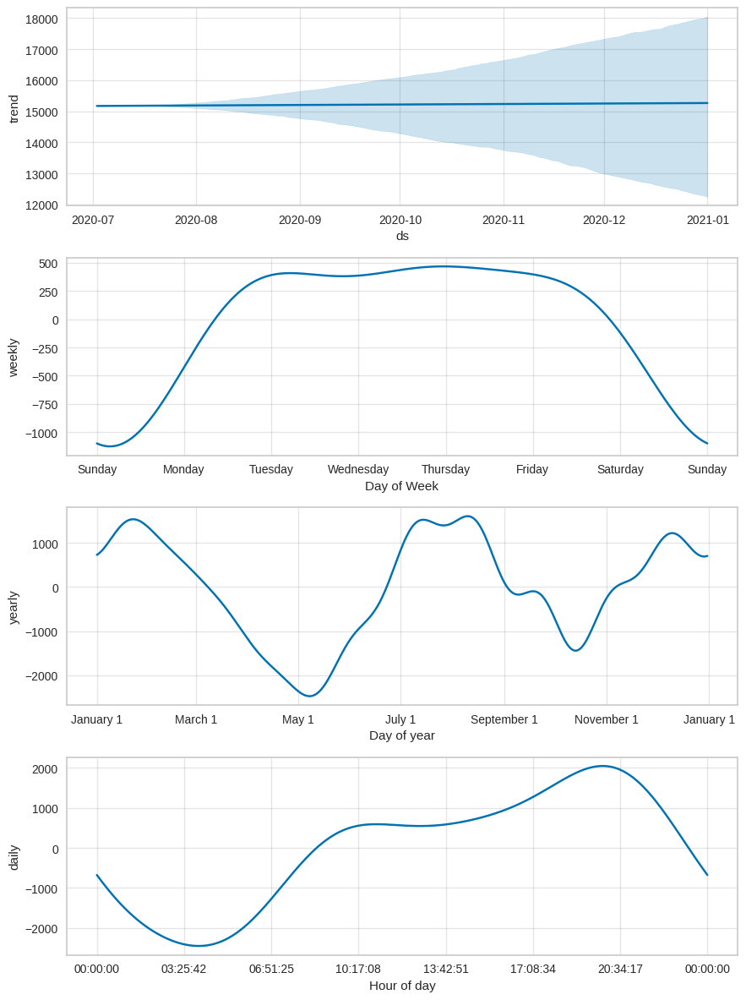

In [ ]:
fig2 = m.plot_components(forecast)

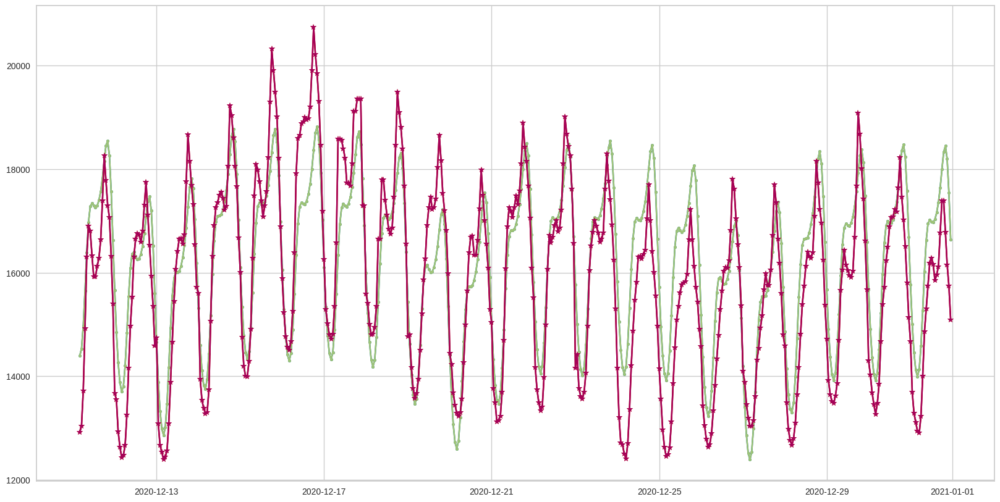

In [ ]:
x = test_demand['ds'].reset_index()
plt.figure(figsize=(20,10))
plt.plot(x.iloc[-500:], forecast['yhat'].iloc[-500:], label='Pred', marker='.')
plt.plot(x.iloc[-500:], test_demand['y'].iloc[-500:], label='True', marker='*')

In [ ]:
mean_absolute_error(y_true=test_demand['y'],
                   y_pred=forecast['yhat'])

1145.3151731694518

In [ ]:
mean_absolute_percentage_error(y_true=test_demand['y'],
                   y_pred=forecast['yhat'])

7.372858931252782